<a href="https://colab.research.google.com/github/danmenloz/LeafWilting/blob/main/Results.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Team 21
## Project 1.2: Leaf Wilting Detection in Soybean
This script is used to show the prediction results of the trained the model.

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import cv2
import os
import seaborn as sns
 
import keras
from keras.models import load_model
from keras.preprocessing import image_dataset_from_directory

from sklearn.metrics import classification_report, confusion_matrix, f1_score

### Methods
These methods are useful to handle image data.

In [ ]:
def loadImages(path):
    # list with paths of all images in the folder
    f_paths = sorted([os.path.join(path, file)
                          for file in os.listdir(path)
                          if file.endswith('.jpg')])
    # list with file names of the images
    f_names = [ os.path.basename(i) for i in f_paths ]
    # list with images
    images = [ plt.imread(i) for i in f_paths ]

    return f_names, images


def reduceImages(images, imgNewSz):
  #Reduce the images by pixel size
  reduced_images = []
  for i in images:
    rimg = cv2.resize(i, (imgNewSz,imgNewSz), interpolation = cv2.INTER_LINEAR)
    # rimg = cv2.resize(i, None, fx=ratio, fy=ratio, interpolation = cv2.INTER_AREA)
    reduced_images.append(rimg)

  reduced_images = np.array(reduced_images)
  return reduced_images


def countLabels(labels):
  print("Class 0:", np.sum(labels == 0))
  print("Class 1:", np.sum(labels == 1))
  print("Class 2:", np.sum(labels == 2))
  print("Class 3:", np.sum(labels == 3))
  print("Class 4:", np.sum(labels == 4))
  print(" Total :", len(labels))
  print("") # enter

In [ ]:
#Access data in Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Load Model
Here we load the best model observed during training.

In [ ]:
# Load best model 
base_path = "drive/My Drive/ECE_542-Project_1/"
save_path = os.path.join(base_path,'vgg16_model.h5')
datasets_paths = [ os.path.join(base_path,'data/test/'),
                   os.path.join(base_path,'data/train/'),
                   os.path.join(base_path,'data/validation/'),
                   os.path.join(base_path,'data/prediction/') ]
img_size = (224,224) # standard image size for the VGG16 model
model = load_model(save_path)

### Training dataset
Load, predict labels and evaluate performance for images used during training.

In [ ]:
# Load training dataset in a single batch
train_ds = image_dataset_from_directory(datasets_paths[1], batch_size=825, image_size=img_size, label_mode='int', shuffle='False')
data_train, labels_train = next(iter(train_ds))

# Scale images before feeding them into the model
data_train = np.asarray(data_train)*1.0/255
print('data_train=%s, min=%.3f, max=%.3f' % (data_train.shape, data_train.min(), data_train.max()))
print(labels_train.shape)
countLabels(labels_train)

# Predict labels
base_results = model.predict(data_train)
base_results = np.argmax(base_results,axis=1)

# Accuracy
accuracy = np.sum(base_results == labels_train)/len(base_results)
print("Accuracy training set = %0.2f" %accuracy)
countLabels(base_results)

# F1 Score
base_f1_score = f1_score(labels_train, base_results, average=None)
print(base_f1_score)

Found 825 files belonging to 5 classes.
data_train=(825, 224, 224, 3), min=0.000, max=1.000
(825,)
Class 0: 398
Class 1: 239
Class 2: 40
Class 3: 41
Class 4: 107
 Total : 825

Accuracy training set = 0.79
Class 0: 337
Class 1: 241
Class 2: 81
Class 3: 60
Class 4: 106
 Total : 825

[0.85170068 0.7375     0.44628099 0.69306931 0.92957746]


### Validation dataset
Load, predict labels and evaluate performance for images used during training.

Found 350 files belonging to 5 classes.
data_train=(350, 224, 224, 3), min=0.000, max=1.000
(350,)
Class 0: 70
Class 1: 70
Class 2: 70
Class 3: 70
Class 4: 70
 Total : 350

Accuracy validation set = 0.85
Class 0: 68
Class 1: 61
Class 2: 65
Class 3: 88
Class 4: 68
 Total : 350

[0.85507246 0.80916031 0.75555556 0.83544304 0.97101449]
              precision    recall  f1-score   support

           0       0.87      0.84      0.86        70
           1       0.87      0.76      0.81        70
           2       0.78      0.73      0.76        70
           3       0.75      0.94      0.84        70
           4       0.99      0.96      0.97        70

    accuracy                           0.85       350
   macro avg       0.85      0.85      0.85       350
weighted avg       0.85      0.85      0.85       350



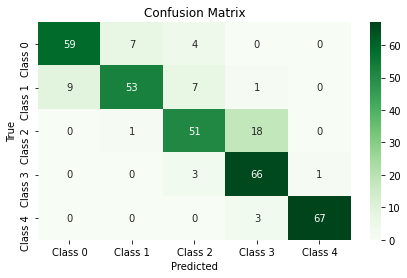

In [ ]:
# Load training dataset in a single batch
valid_ds = image_dataset_from_directory(datasets_paths[2], batch_size=350, image_size=img_size, label_mode='int', shuffle='False')
data_valid, labels_valid = next(iter(valid_ds))

# Scale images before feeding them into the model
data_valid = np.asarray(data_valid)*1.0/255
print('data_train=%s, min=%.3f, max=%.3f' % (data_valid.shape, data_valid.min(), data_valid.max()))
print(labels_valid.shape)
countLabels(labels_valid)

# Predict labels
base_results = model.predict(data_valid)
base_results = np.argmax(base_results,axis=1)

# Accuracy
accuracy = np.sum(base_results == labels_valid)/len(base_results)
print("Accuracy validation set = %0.2f" %accuracy)
countLabels(base_results)

# F1 Score
base_f1_score = f1_score(labels_valid, base_results, average=None)
print(base_f1_score)

# Confussion matrix
axis_labels = ["Class 0","Class 1", "Class 2", "Class 3", "Class 4"]
confM = confusion_matrix(labels_valid, base_results)
fig, ax = plt.subplots(figsize=(7,4)) 
sns.heatmap(confM, annot=True,cmap="Greens",fmt='g', xticklabels=axis_labels, yticklabels=axis_labels,ax=ax)
plt.title('Confusion Matrix')
plt.ylabel('True')
plt.xlabel('Predicted')

# Classification report
t = classification_report(labels_valid, base_results)
print(t)

### Pre-test dataset
Load, predict labels and evaluate performance for unseen images.

Found 100 files belonging to 5 classes.
pre_test_images=(100, 224, 224, 3), min=0.000, max=1.000
(100,)
Class 0: 20
Class 1: 20
Class 2: 20
Class 3: 20
Class 4: 20
 Total : 100

Accuracy test set = 0.79
Class 0: 18
Class 1: 18
Class 2: 19
Class 3: 27
Class 4: 18
 Total : 100

[0.78947368 0.84210526 0.61538462 0.76595745 0.94736842]
              precision    recall  f1-score   support

           0       0.83      0.75      0.79        20
           1       0.89      0.80      0.84        20
           2       0.63      0.60      0.62        20
           3       0.67      0.90      0.77        20
           4       1.00      0.90      0.95        20

    accuracy                           0.79       100
   macro avg       0.80      0.79      0.79       100
weighted avg       0.80      0.79      0.79       100



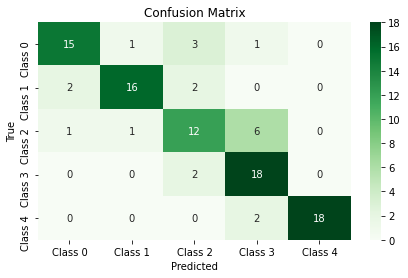

In [ ]:
# Load pre-test dataset in a single batch
test_ds = image_dataset_from_directory(datasets_paths[0], batch_size=100, image_size=img_size, label_mode='int', shuffle='True')
pre_test_images, pre_test_labels = next(iter(test_ds))

# Scale images before feeding them into the model
pre_test_images = np.asarray(pre_test_images)*1.0/255
print('pre_test_images=%s, min=%.3f, max=%.3f' % (pre_test_images.shape, pre_test_images.min(), pre_test_images.max()))
print(pre_test_labels.shape)
countLabels(pre_test_labels)

# Predict labels
pre_test_results = model.predict(pre_test_images)
pre_test_results = np.argmax(pre_test_results,axis=1)

# Accuracy
accuracy = np.sum(pre_test_results == pre_test_labels)/len(pre_test_labels)
print("Accuracy pre-test set = %0.2f" %accuracy)
countLabels(pre_test_results)

# F1 Score
trueY = pre_test_labels
test_f1_score = f1_score(trueY, pre_test_results, average=None)
print(test_f1_score)

# Confussion matrix
axis_labels = ["Class 0","Class 1", "Class 2", "Class 3", "Class 4"]
confM = confusion_matrix(pre_test_labels, pre_test_results)
fig, ax = plt.subplots(figsize=(7,4)) 
sns.heatmap(confM, annot=True,cmap="Greens",fmt='g', xticklabels=axis_labels, yticklabels=axis_labels,ax=ax)
plt.title('Confusion Matrix')
plt.ylabel('True')
plt.xlabel('Predicted')

# Classification report
t = classification_report(pre_test_labels, pre_test_results)
print(t)

### Generate CSV file
Here we load the TestData images, predict the labels and generate the prediction.csv file.

In [ ]:
# Retreive file names
test_path = "/content/drive/My Drive/ECE_542-Project_1/prediction"
file_name, images = loadImages(test_path)

# Reduce image size
test_images = reduceImages(images, img_size[0])

# Scale images before feedint them into the model
test_images = np.asarray(test_images)*1.0/255
print('test_images=%s, min=%.3f, max=%.3f' % (test_images.shape, test_images.min(), test_images.max()))

# Predict labels
test_results = model.predict(test_images)
test_results = np.argmax(test_results,axis=1)
countLabels(test_results)

# Generate CSV file
data = {'file_name': file_name,'annotation': test_results  }
export_data = pd.DataFrame(data, columns=['file_name', 'annotation'])
export_data.to_csv (r'/content/drive/My Drive/ECE_542-Project_1/prediction.csv', index = False, header=True)
print(export_data)

test_images=(200, 224, 224, 3), min=0.000, max=1.000
Class 0: 41
Class 1: 80
Class 2: 22
Class 3: 3
Class 4: 54
 Total : 200

      file_name  annotation
0    020031.jpg           1
1    020244.jpg           4
2    020446.jpg           4
3    020597.jpg           2
4    020693.jpg           1
..          ...         ...
195  029650.jpg           1
196  029787.jpg           4
197  029841.jpg           1
198  029866.jpg           1
199  029897.jpg           0

[200 rows x 2 columns]


### Visualize and inspect the results
Worth spending some time here to make sure that prediction makes sense.

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


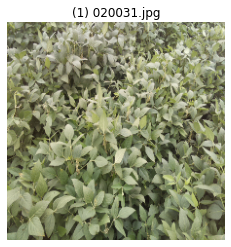

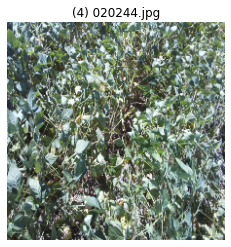

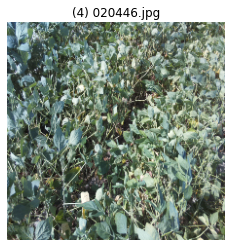

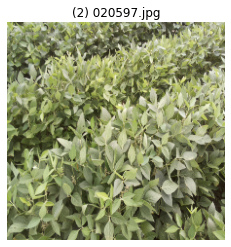

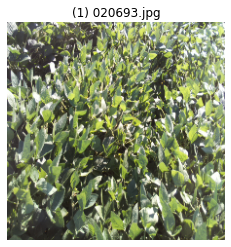

...

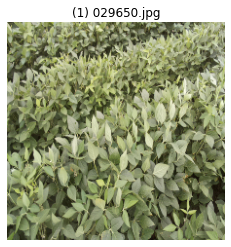

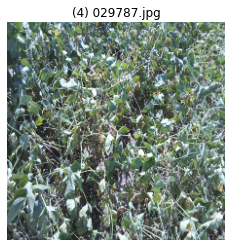

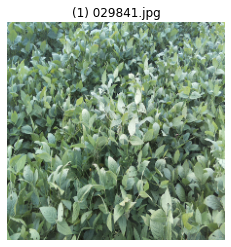

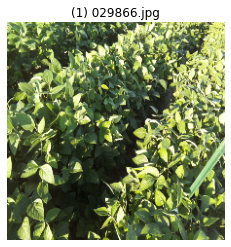

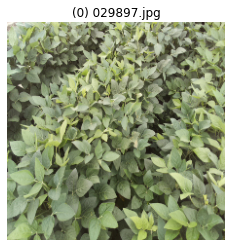

In [ ]:
test_results #labels
file_name #file names
test_images #images

for i,(label,name,image) in enumerate(zip(test_results,file_name,test_images)):
  plt.figure(i+1)
  plt.imshow(image)
  plt.title('('+str(label)+') ' + name)
  plt.axis("off")